# Kaggle medical picture process

## Using an example to show split patches

In [1]:
import cv2
import os
import matplotlib.pyplot as plt

In [2]:
cv2.__version__

'4.6.0'

In [3]:
PATH = r"E:\data\universe"

img = cv2.imread(os.path.join(PATH, "Universe01.jpg"))

# check loading
if img is None:
    print("filed")
else:
    print("Loading succeed")

Loading succeed


In [4]:
img.shape

(1600, 2560, 3)

(-0.5, 2559.5, 1599.5, -0.5)

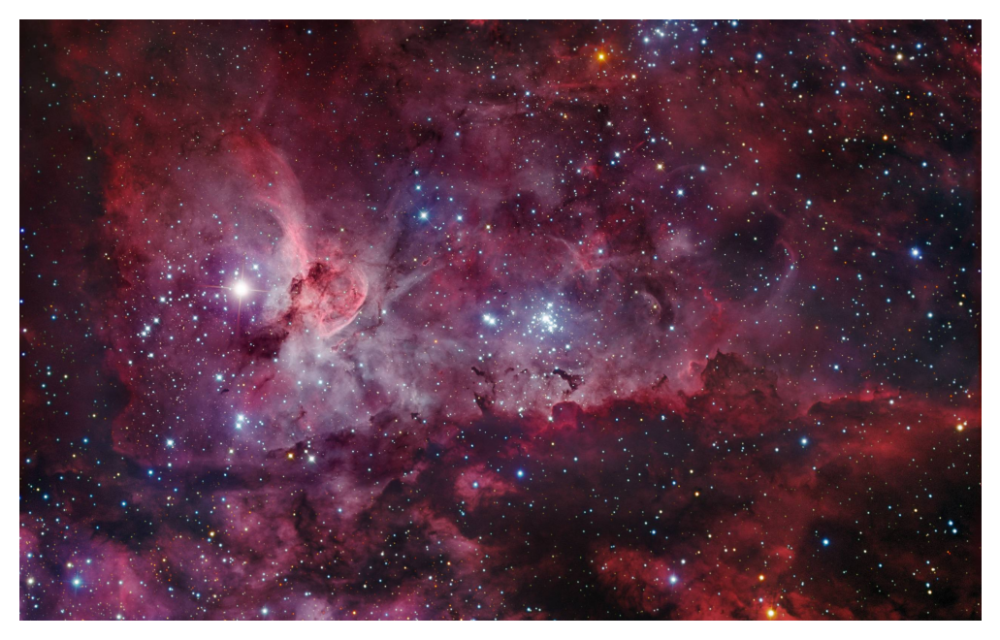

In [5]:
# check image
imgcopy = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
plt.figure(dpi=200)
plt.imshow(imgcopy)
plt.axis('off')

In [ ]:
imgcopy = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

imgheight = imgcopy.shape[0]
imgweight = imgcopy.shape[1]

patch_height = 50
patch_weight = 50

for y in range(0, imgheight, patch_height):
    for x in range(0, imgweight, patch_weight):

        # check
        if patch_height > imgheight or patch_weight > imgweight:
            print("Over size!!")
            break

        y_ = y + patch_height
        x_ = x + patch_weight

        if imgheight >= y_ and imgweight >= x_:
            patch = img[y:y_, x:x_]

            cv2.imwrite(os.path.join(PATH, "patches", "universe"+"x" +
                        str(x)+"_"+str(x_)+"y"+str(y)+"_"+str(y_)+".jpg"), patch)

            cv2.rectangle(imgcopy, (x, y), (x_, y_), (255, 255, 2555), 2)

plt.figure(dpi=300)
plt.imshow(imgcopy)
plt.axis('off')

In [6]:
def load_images_from_fold(folder):
    imgs = []  # save image object into list
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder, filename))
        if img is not None:
            imgs.append(img)
    return imgs

In [7]:
imgs = load_images_from_fold(PATH)

In [8]:
len(imgs)

4

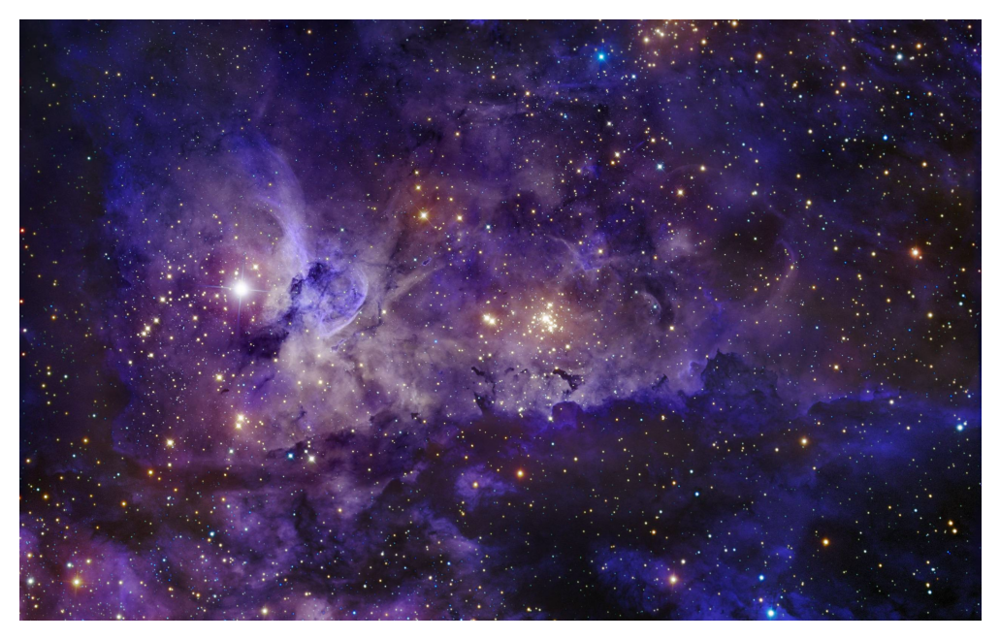

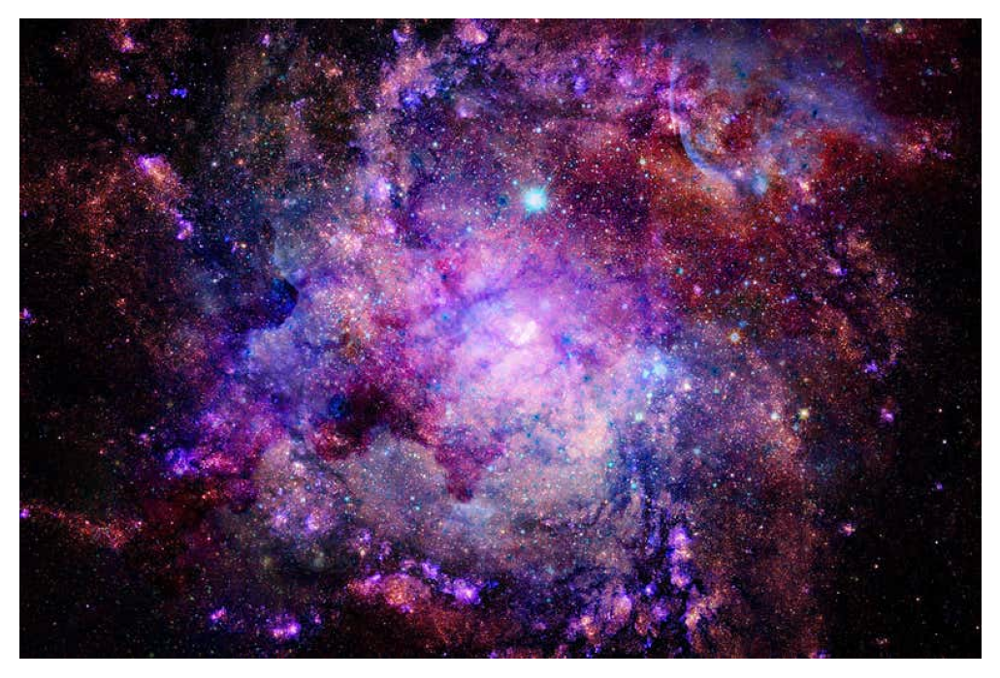

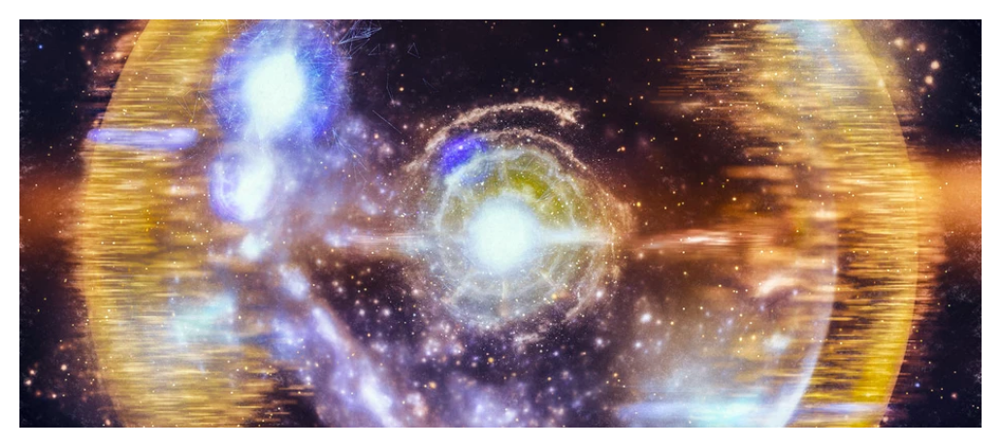

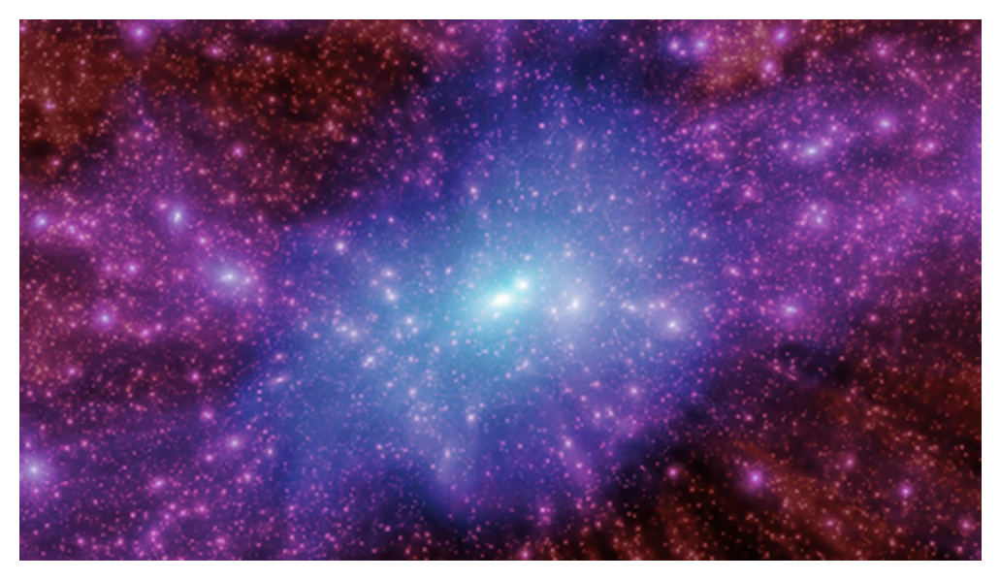

In [9]:
for i in imgs:
    plt.figure(dpi=200)
    plt.imshow(i)
    plt.axis('off')

In [12]:
def extract_images_folder(folder):
    """load images and process each image"""

    # load images
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder, filename))

        if img is not None:
            subfolder = os.path.join(PATH, filename.split(".")[0])
            if os.path.exists(subfolder):
                print("folder exists")
            else:
                os.mkdir(subfolder)

            # process image
            imgcopy = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

            imgheight = imgcopy.shape[0]
            imgweight = imgcopy.shape[1]

            patch_height = 50
            patch_weight = 50

            for y in range(0, imgheight, patch_height):
                for x in range(0, imgweight, patch_weight):

                    # check
                    if patch_height > imgheight or patch_weight > imgweight:
                        print("Over size!!")
                        break

                    y_ = y + patch_height
                    x_ = x + patch_weight

                    if imgheight >= y_ and imgweight >= x_:
                        patch = img[y:y_, x:x_]

                        cv2.imwrite(os.path.join(subfolder, str(filename.split(".")[
                                    0])+"x"+str(x)+"_"+str(x_)+"y"+str(y)+"_" + str(y_) + ".jpg"), patch)

                        cv2.rectangle(imgcopy, (x, y), (x_, y_),
                                      (255, 255, 2555), 2)

            plt.figure(dpi=300)
            plt.imshow(imgcopy)
            plt.axis('off')

folder exists
folder exists
folder exists
folder exists


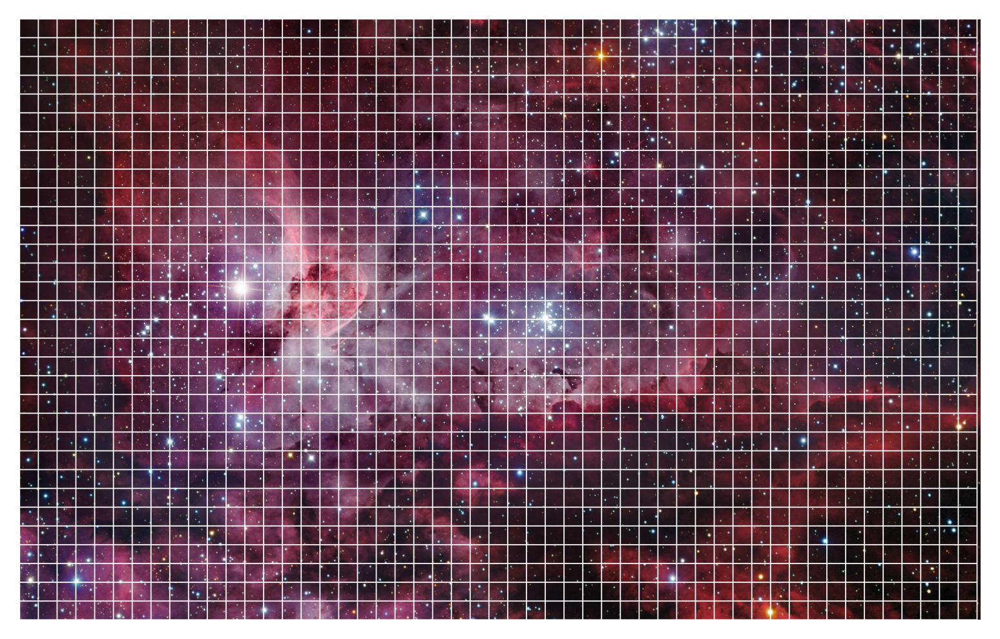

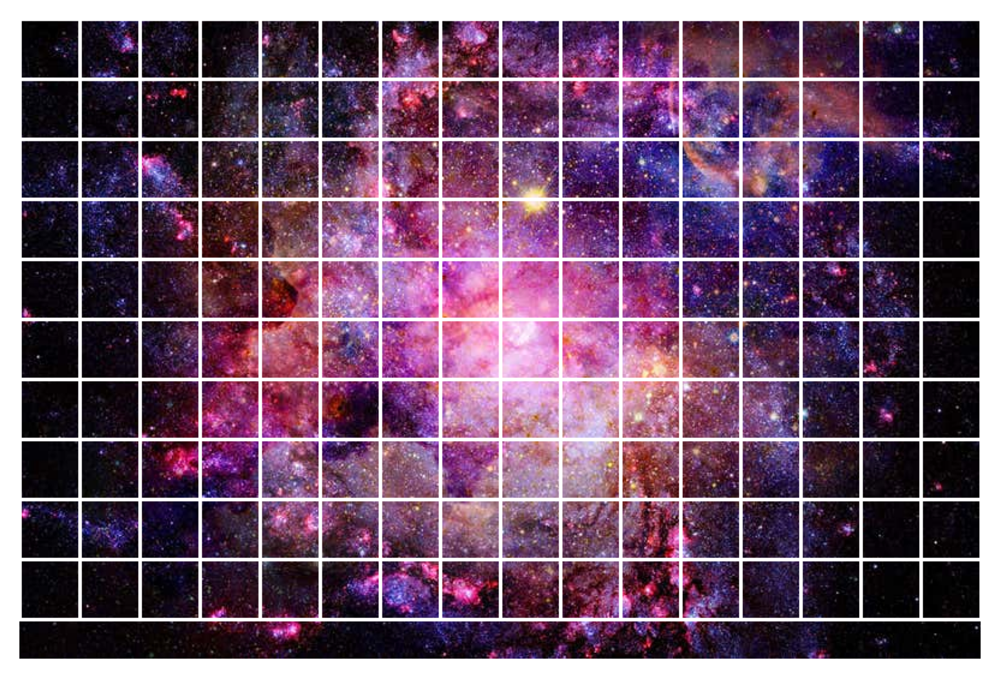

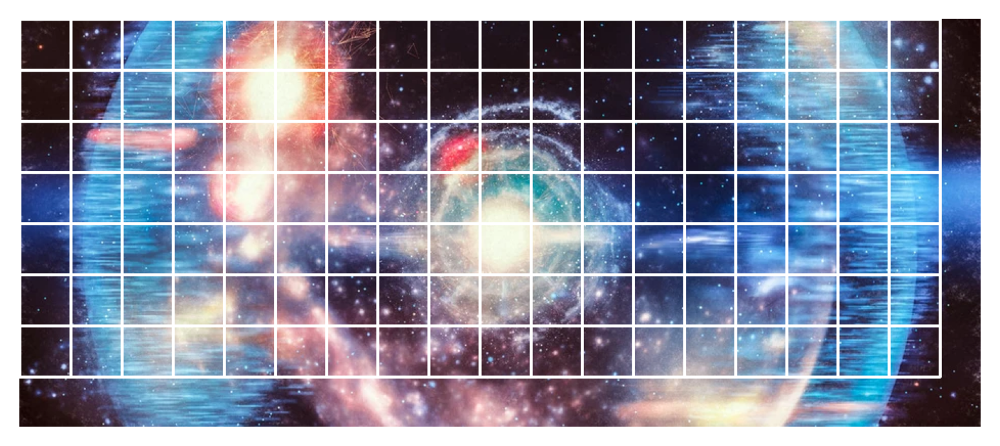

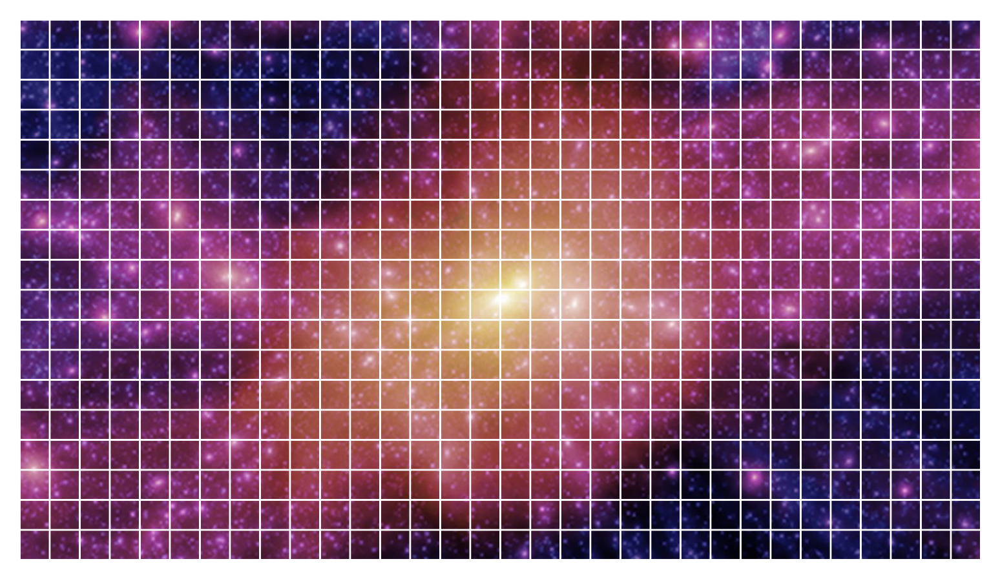

In [13]:
extract_images_folder(PATH)

## Data Process and Visualization

In [14]:
PATH = r"E:\data\IDC_ps50"

In [15]:
patients = os.listdir(PATH)

In [16]:
len(patients)

279

In [17]:
patients[:10]

['10253',
 '10254',
 '10255',
 '10256',
 '10257',
 '10258',
 '10259',
 '10260',
 '10261',
 '10262']

Get any patients ID, each file including sicked patch

In [18]:
# Statistic Data
positive_patches = 0
negative_patches = 0

for patient_id in patients:
    class0_patch = os.path.join(PATH, patient_id, str(0))
    class0_patchs = os.listdir(class0_patch)
    negative_patches += len(class0_patchs)

    class1_patch = os.path.join(PATH, patient_id, str(1))
    class1_patchs = os.listdir(class1_patch)
    positive_patches += len(class1_patchs)

In [19]:
positive_patches

78786

In [20]:
total_patches = positive_patches + negative_patches
total_patches

277524

In [21]:
import pandas as pd

data = pd.DataFrame(index=np.arange(0, total_patches),
                    columns=["patient_id", "path", "target"])

idx = 0
for patient_id in patients:
    for label in [0, 1]:
        class_path = os.path.join(PATH, patient_id, str(label))
        class_pathes = os.listdir(class_path)

        for patch in class_pathes:
            data.loc[idx, "path"] = os.path.join(class_path, patch)
            data.loc[idx, "target"] = label
            data.loc[idx, "patient_id"] = patient_id
            idx += 1

In [22]:
idx

277524

In [23]:
data.head()

,patient_id,path,target
0,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y100...,0
1,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y105...,0
2,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y110...,0
3,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y115...,0
4,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y120...,0


In [24]:
data["path"][0]

'E:\\data\\IDC_ps50\\10253\\0\\10253_idx5_x1001_y1001_class0.png'

In [25]:
(data.isnull()).sum()

patient_id    0
path          0
target        0
dtype: int64

In [26]:
selection = np.random.choice(data.index.values, size=50, replace=False)

In [27]:
selection

array([162301,  70673, 205114, 233082,  73234,  24676,  28412,  73694,
       110155, 164593, 208749, 152157, 263918, 227799,  58593, 145638,
       277321,  86099,  40117, 256845, 122969, 182885,   3506, 258370,
        26736, 220062, 224466,  39719,  49378, 276183, 130616, 181838,
        96806,  27298, 270642, 109164,  40737,  36299, 254381, 185331,
       110149,  27588, 262703, 241816, 220073,   8154, 257988, 207055,
        90955, 102922], dtype=int64)

(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)
(50, 50, 3)


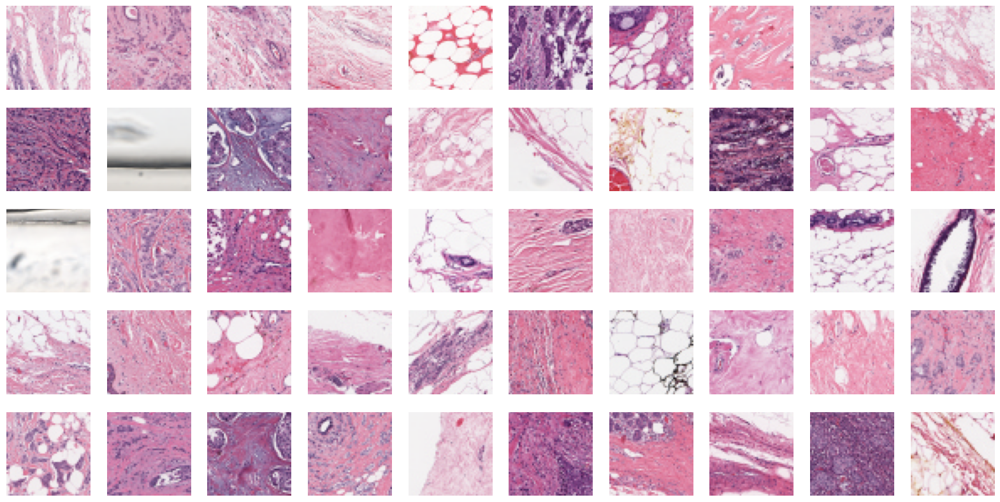

In [28]:
fig, axs = plt.subplots(5, 10, figsize=(20, 10))

for n in range(5):
    for m in range(10):
        idx = selection[m+10*n]
        img = cv2.imread(data.loc[idx, "path"])

        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            print(img.shape)
        else:
            print("No Image")

        axs[n, m].imshow(img)
        axs[n, m].grid(False)
        axs[n, m].axis("off")

In [30]:
pos_selection = np.random.choice(
    data[data.target == 1].index.values, size=50, replace=False)
neg_selection = np.random.choice(
    data[data.target == 0].index.values, size=50, replace=False)

In [31]:
pos_selection

array([195099, 176823, 162826, 145738, 122009, 177831, 149412,  79847,
       179788,  18623, 239042, 247998, 193647,  64207, 148169,  34552,
        52720, 239235, 174748,  97445,  37286, 108082, 157382,  81331,
        60249, 253260, 105958, 227263, 155083, 111051,  68767,  74521,
       186015,  36463, 215316, 118912,  20970, 109030,  88957, 135016,
        35489,  74522, 130783, 108267,   2680, 208790, 155854, 230000,
       153173,  59678], dtype=int64)

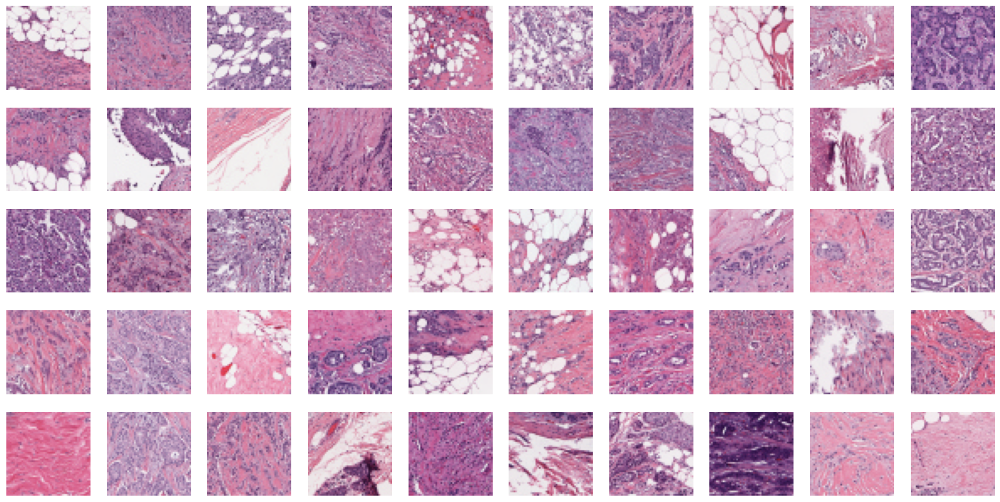

In [32]:
fig, axs = plt.subplots(5, 10, figsize=(20, 10))

for n in range(5):
    for m in range(10):
        idx = pos_selection[m+10*n]
        image = cv2.imread(data.loc[idx, "path"])
        if image is not None:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        axs[n, m].imshow(image)
        axs[n, m].grid(False)
        axs[n, m].axis("off")

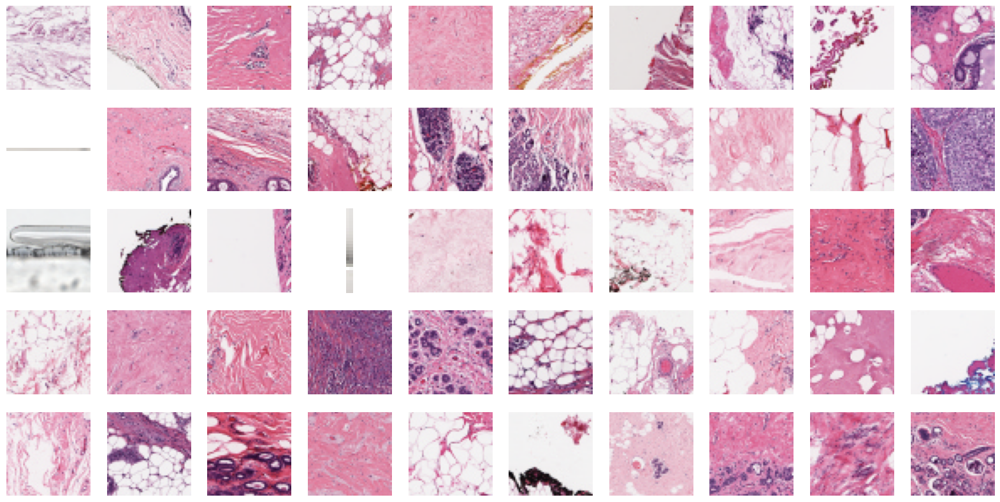

In [33]:
fig, axs = plt.subplots(5, 10, figsize=(20, 10))

for n in range(5):
    for m in range(10):
        idx = neg_selection[m+10*n]
        image = cv2.imread(data.loc[idx, "path"])
        if image is not None:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        axs[n, m].imshow(image)
        axs[n, m].grid(False)
        axs[n, m].axis("off")

In [34]:
data.head()

,patient_id,path,target
0,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y100...,0
1,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y105...,0
2,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y110...,0
3,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y115...,0
4,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y120...,0


In [35]:
data["target"].value_counts()

0    198738
1     78786
Name: target, dtype: int64

In [36]:
data["target"].value_counts()[1]/data["target"].shape[0]

0.28388896095472826

In [37]:
data.columns

Index(['patient_id', 'path', 'target'], dtype='object')

In [38]:
data.head()

,patient_id,path,target
0,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y100...,0
1,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y105...,0
2,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y110...,0
3,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y115...,0
4,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y120...,0


In [39]:
data.groupby("patient_id")["target"].count().describe()

count     279.000000
mean      994.709677
std       550.603474
min        63.000000
25%       560.500000
50%       967.000000
75%      1362.000000
max      2395.000000
Name: target, dtype: float64

In [40]:
table = data.pivot_table(index='patient_id', columns='target', aggfunc='count')

In [41]:
table.head()

path     
target        0    1
patient_id          
10253       479   70
10254       772   76
10255       181   91
10256       351  117
10257       427  208

In [42]:
table.columns = ["0", "1"]
table.index = patients

In [43]:
table.head()

,0,1
10253,479,70
10254,772,76
10255,181,91
10256,351,117
10257,427,208


In [44]:
table["wholepicture"] = table["0"] + table["1"]
table["positive_ratio"] = table["1"]/table["wholepicture"]

In [45]:
table.sort_values("positive_ratio", ascending=False).head(10)

,0,1,wholepicture,positive_ratio
14209,33,309,342,0.903509
9262,14,80,94,0.851064
12873,49,232,281,0.825623
9077,360,1263,1623,0.778189
12241,37,115,152,0.756579
8957,28,83,111,0.747748
15633,114,337,451,0.747228
10275,297,760,1057,0.719016
13694,360,870,1230,0.707317
15514,197,441,638,0.691223


In [46]:
table.sort_values("positive_ratio", ascending=True).head(10)

,0,1,wholepicture,positive_ratio
10305,1802,19,1821,0.010434
10268,2086,23,2109,0.010906
10272,2150,25,2175,0.011494
16085,1913,24,1937,0.012390
12750,1413,21,1434,0.014644
12905,1193,21,1214,0.017298
10300,1464,29,1493,0.019424
10288,2231,47,2278,0.020632
10259,1434,31,1465,0.021160
12869,778,18,796,0.022613


In [47]:
data["x"] = data["path"].apply(lambda x: int(x.split("_")[-3][1:]))
data["y"] = data["path"].apply(lambda x: int(x.split("_")[-2][1:]))

In [48]:
data.head()

,patient_id,path,target,x,y
0,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y100...,0,1001,1001
1,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y105...,0,1001,1051
2,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y110...,0,1001,1101
3,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y115...,0,1001,1151
4,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y120...,0,1001,1201


In [49]:
import seaborn as sns


def visualize_single_patient(patient_id):
    singlepatient = data[data["patient_id"] == patient_id]
    sns.set()
    plt.scatter(singlepatient["x"], singlepatient["y"],
                c=singlepatient["target"], cmap="coolwarm", s=10)
    plt.grid(linewidth=1, color="white")

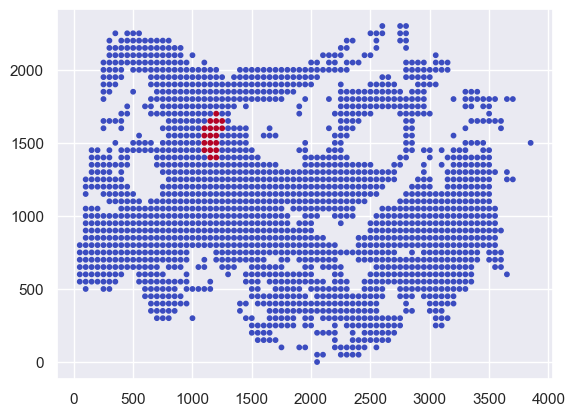

In [51]:
visualize_single_patient("10305")

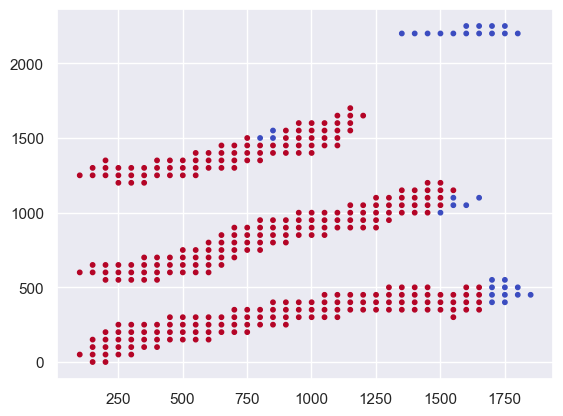

In [50]:
visualize_single_patient("14209")

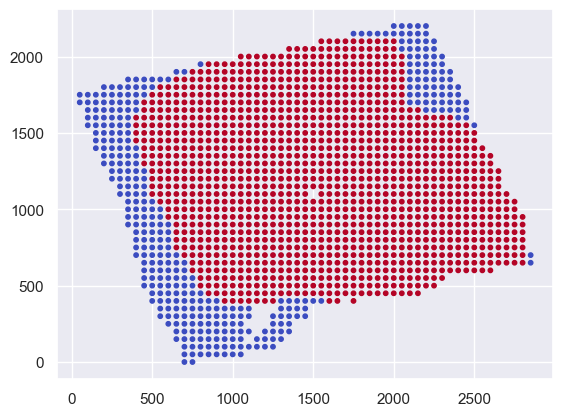

In [52]:
visualize_single_patient("9077")

In [53]:
np.random.shuffle(data["patient_id"].unique())

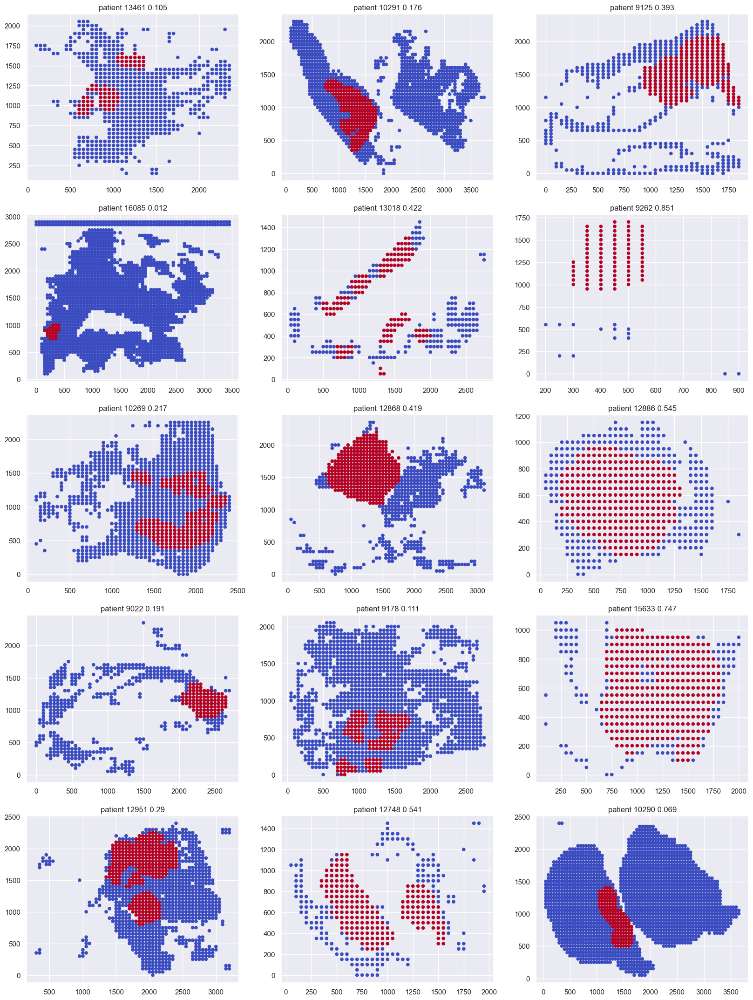

In [54]:
fig, axs = plt.subplots(5,3,figsize=(20, 27))
patient_ids = data["patient_id"].unique()
np.random.shuffle(patient_ids)

for n in range(5):
    for m in range(3):
        patient_id = patient_ids[m+3*n] 
        singlepatient = data[data["patient_id"] == patient_id]
        axs[n,m].scatter(singlepatient["x"],singlepatient["y"],c=singlepatient["target"],cmap="coolwarm",s=20)
        axs[n,m].set_title("patient " + patient_id + " " + str(round(table.loc[patient_id,"positive_ratio"],3)))

## Custom Dataset

In [55]:
data.shape

(277524, 5)

In [56]:
data.head()

,patient_id,path,target,x,y
0,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y100...,0,1001,1001
1,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y105...,0,1001,1051
2,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y110...,0,1001,1101
3,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y115...,0,1001,1151
4,10253,E:\data\IDC_ps50\10253\0\10253_idx5_x1001_y120...,0,1001,1201


In [61]:
from sklearn.model_selection import train_test_split

train,test_val = train_test_split(data,test_size=0.3,random_state=1412,
                                  stratify=data["target"]
                                  )

test,val = train_test_split(test_val,test_size=0.5,random_state=1412,
                            stratify=test_val["target"]
                            )

In [62]:
train.head()

,patient_id,path,target,x,y
135365,13617,E:\data\IDC_ps50\13617\0\13617_idx5_x2001_y301...,0,2001,301
224966,9075,E:\data\IDC_ps50\9075\0\9075_idx5_x401_y1651_c...,0,401,1651
262135,9319,E:\data\IDC_ps50\9319\0\9319_idx5_x1551_y651_c...,0,1551,651
224003,9075,E:\data\IDC_ps50\9075\0\9075_idx5_x1251_y1001_...,0,1251,1001
58513,12751,E:\data\IDC_ps50\12751\0\12751_idx5_x2751_y401...,0,2751,401


In [63]:
for i in [train,test,val]:
    print(i.shape)
    # 1/totall
    print(i["target"].value_counts()[1]/i['target'].shape[0])
    print('---------')

(194266, 5)
0.28388910051166955
---------
(41629, 5)
0.283888635326335
---------
(41629, 5)
0.283888635326335
---------


- Define Dataset

In [69]:
from torch.utils.data import Dataset
from skimage import io
import torch

In [70]:
class CustomDataset(Dataset):
    def __init__(self,df,transform=None):
        super().__init__()
        self.path_label = df 
        self.transform = transform
        
    def __len__(self):
        return self.path_label.shape[0]
    
    def __info__(self):
        print("IDC data")
        print("\t Number of Samples: {}".format(self.path_label.shape[0]))
        print("\t Number of patients: {}".format(len(self.path_label['patient_id'].unique())))
        
    def __getitem__(self,idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
            
        patient_id = self.path_label['patient_id'].values[idx]
        image_path = self.path_label['path'].values[idx]
        image = io.imread(image_path)
        label = self.path_label['target'].values[idx]
        
        if self.transform:
            image = self.transform(image)
            
        sample = {'patch':image,
                 'label':label,
                 'patient':patient_id}
        
        return sample

In [72]:
# check
test_ = CustomDataset(test)

In [73]:
test_.__len__()

41629

In [74]:
test_[2]["patient"]

'10272'

## Color enhance based imgaug&skimage

In [76]:
pip install imgaug

In [78]:
import imgaug as ia
from imgaug import augmenters as iaa
from skimage import io

In [79]:
train.head()

,patient_id,path,target,x,y
135365,13617,E:\data\IDC_ps50\13617\0\13617_idx5_x2001_y301...,0,2001,301
224966,9075,E:\data\IDC_ps50\9075\0\9075_idx5_x401_y1651_c...,0,401,1651
262135,9319,E:\data\IDC_ps50\9319\0\9319_idx5_x1551_y651_c...,0,1551,651
224003,9075,E:\data\IDC_ps50\9075\0\9075_idx5_x1251_y1001_...,0,1251,1001
58513,12751,E:\data\IDC_ps50\12751\0\12751_idx5_x2751_y401...,0,2751,401


In [80]:
train['path'][0]

'E:\\data\\IDC_ps50\\10253\\0\\10253_idx5_x1001_y1001_class0.png'

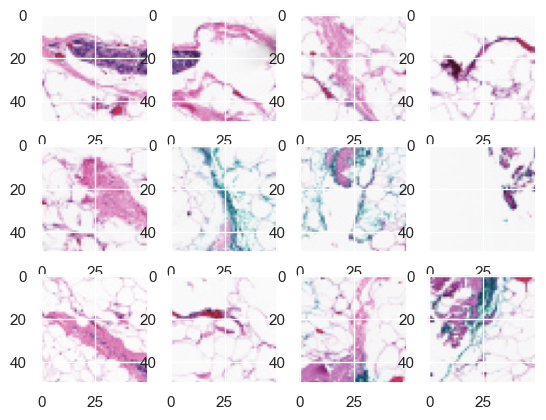

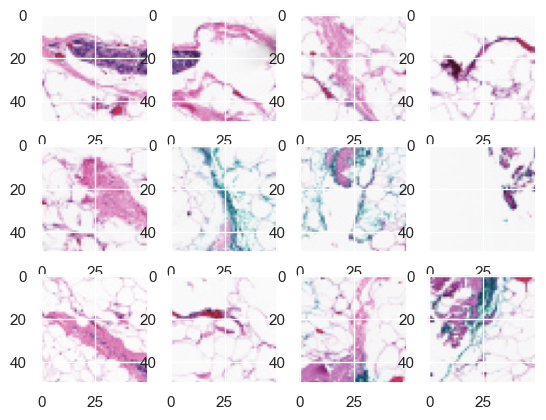

In [81]:
imgs = io.imread_collection(r'E:\\data\\IDC_ps50\\10253\\0\\*.png')
io.imshow_collection(imgs[:12])

In [82]:
imgs

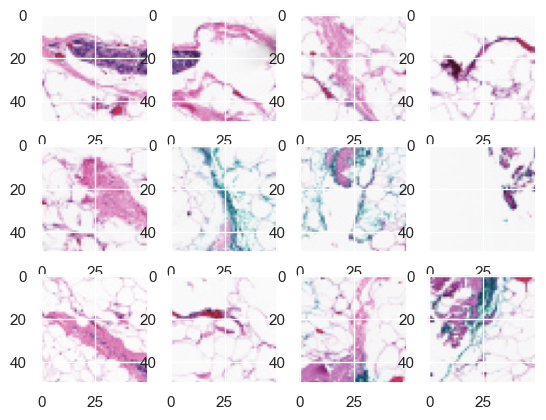

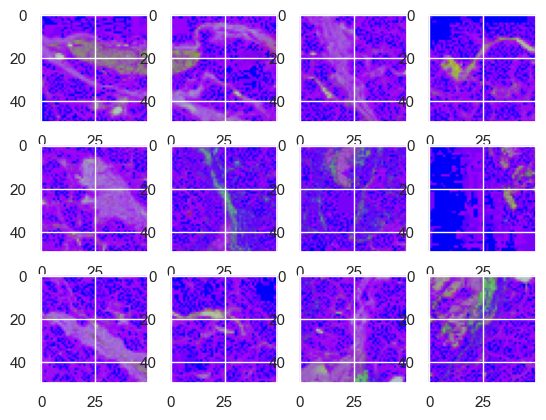

In [83]:
# RGB - HSV
aug = iaa.ChangeColorspace(to_colorspace='HSV')
imgs_aug = aug(images = imgs)
io.imshow_collection(imgs[:12]);
io.imshow_collection(imgs_aug[:12]);

In [84]:
#RGB - HED
from skimage.color import rgb2hed, hed2rgb
from skimage.exposure import rescale_intensity

C:\Users\WenBi\anaconda3\envs\24723_Pytorch\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


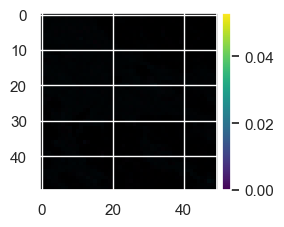

In [85]:
img = io.imread(train.iloc[0,1])
img_aug = rgb2hed(img)
plt.figure(figsize=(3,3))
io.imshow(img_aug);

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


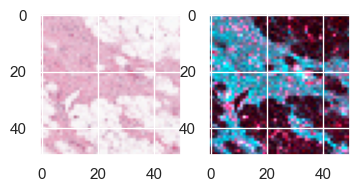

In [86]:
for channel in [0,1,2]:
    img_aug[:,:,channel] = rescale_intensity(img_aug[:, :, channel], out_range=(0,2))

fig, axes = plt.subplots(1,2,figsize=(4,2))
axes[0].imshow(img);
axes[1].imshow(img_aug);

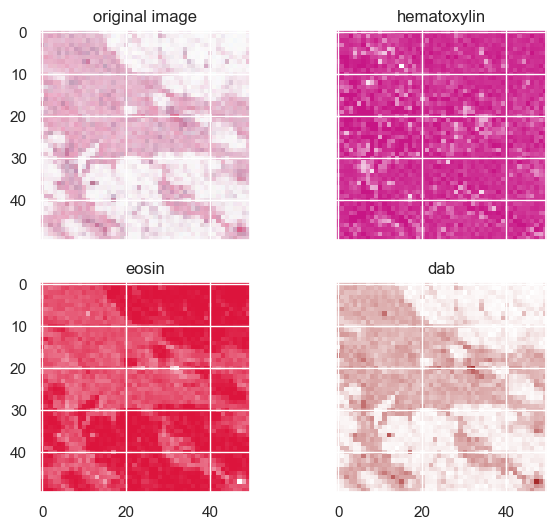

In [87]:
from matplotlib.colors import LinearSegmentedColormap

cmap_hema = LinearSegmentedColormap.from_list('mycmap',['mediumvioletred','white'])
cmap_dab = LinearSegmentedColormap.from_list('mycmap',['white','brown'])
cmap_eosin = LinearSegmentedColormap.from_list('mycmap',['crimson','white'])

fig, axes = plt.subplots(2,2,figsize=(7,6), sharex=True ,sharey=True ,subplot_kw={'adjustable':'box'})
ax = axes.ravel()

ax[0].imshow(img)
ax[0].set_title('original image')

ax[1].imshow(img_aug[:,:,0],cmap=cmap_hema)
ax[1].set_title('hematoxylin')

ax[2].imshow(img_aug[:,:,1],cmap=cmap_eosin)
ax[2].set_title('eosin')

ax[3].imshow(img_aug[:,:,2],cmap=cmap_dab)
ax[3].set_title('dab');

- Package all preprocessor(expected colorspace)

In [90]:
seq1 = iaa.Sequential([
    iaa.Resize(256),
    iaa.Fliplr(0.5),
    iaa.Flipud(0.5),
    iaa.CropAndPad(percent=(0.01,0.02)),
    iaa.MultiplyAndAddToBrightness(mul=(0.7,1.2),add=(-10,10)),
    iaa.MultiplyHueAndSaturation(mul_hue=(0.9,1.1),mul_saturation=(0.8,1.2)),
    iaa.pillike.EnhanceContrast(factor=(0.75,1.25)),
    iaa.Sometimes(0.5,iaa.AdditiveGaussianNoise(loc=1,scale=(0,0.05*255),per_channel=0.5)),
    iaa.Add((-20,5)),
    iaa.Multiply((0.8,1.2),per_channel=0.2),
    iaa.Affine(scale={'x':(0.9,1.1),'y':(0.9,1.1)},
              translate_percent={'x':(-0.05,0.05),'y':(-0.05,0.05)},
              rotate=(-10,10),
              shear=(-3,3))
],random_order=True)

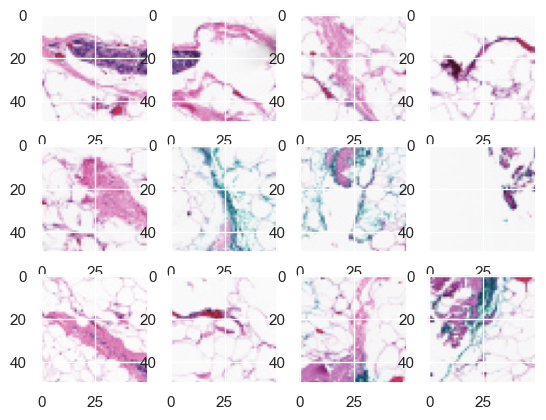

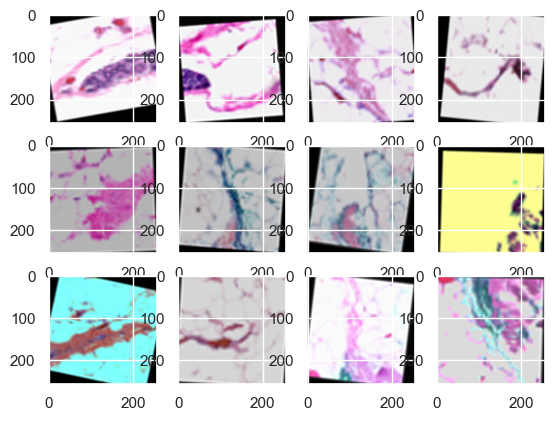

In [91]:
imgs_aug = seq1(images=imgs)
io.imshow_collection(imgs[:12]);
io.imshow_collection(imgs_aug[:12]);

In [92]:
import torchvision.transforms as transforms

In [97]:
def alltransform(key='train',plot=False):
    train_sequence = [seq1.augment_image,transforms.ToPILImage()]
    test_val_sequence = [iaa.Resize(256).augment_image,transforms.ToPILImage()]
    
    if plot == False:
        train_sequence.extend([transforms.ToTensor()
                               ,transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])                      
        test_val_sequence.extend([transforms.ToTensor()
                               ,transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
        
    data_transforms = {'train': transforms.Compose(train_sequence),'test_val':transforms.Compose(test_val_sequence)}
    
    return data_transforms[key]

In [94]:
class CustomDataset(Dataset):
    def __init__(self,df,transform=None):
        super().__init__()
        self.path_label = df 
        self.transform = transform
        
    def __len__(self):
        return self.path_label.shape[0]
    
    def __info__(self):
        print("IDC data")
        print("\t Number of Samples: {}".format(self.path_label.shape[0]))
        print("\t Number of patients: {}".format(len(self.path_label['patient_id'].unique())))
        
    def __getitem__(self,idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
            
        patient_id = self.path_label['patient_id'].values[idx]
        image_path = self.path_label['path'].values[idx]
        image = io.imread(image_path)
        label = self.path_label['target'].values[idx]
        
        if self.transform:
            image = self.transform(image)
            
        sample = {'patch':image,
                 'label':label,
                 'patient':patient_id}
        
        return sample

In [98]:
train_ = CustomDataset(train,transform = alltransform(key='train',plot=True))

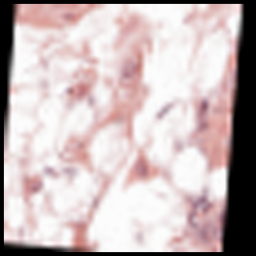

In [99]:
train_[4]["patch"]

In [100]:
train_ = CustomDataset(train,transform = alltransform(key="train",plot=False))

In [101]:
train_[1]["patch"]

tensor([[[-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         ...,
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -2.1179]],

        [[-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         ...,
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0357, -2.0357, -2.0357,  ..., -2.0357, -2.0357, -2.0357]],

        [[-1.8044, -1.8044, -1.8044,  ..., -1.8044, -1.8044, -1.8044],
         [-1.8044, -1.8044, -1.8044,  ..., -1

In [102]:
test_ = CustomDataset(test,transform = alltransform(key="test_val",plot=True))

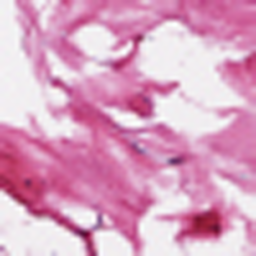

In [103]:
test_[1]["patch"]

- According to paper

In [104]:
seq_all = iaa.Sequential(
            [iaa.Resize(256),iaa.Fliplr(0.5),iaa.Flipud(0.5)
             ,iaa.CropAndPad(percent=(0.01,0.02))
             ,iaa.MultiplyAndAddToBrightness(mul=(0.8,1.2),add=(-10,10))
             ,iaa.MultiplyHueAndSaturation(mul_hue=(0.9,1.2),mul_saturation=(0.8,0.9))
             ,iaa.Affine(scale={"x": (0.9, 1.1), "y": (0.9, 1.1)}
                         ,translate_percent={"x": (-0.05, 0.05), "y": (-0.05, 0.05)}
                         ,rotate=(-10, 10)
                         ,shear=(-3, 3)
                        )
            ]).augment_image

In [105]:
def seq_channel(img,channel=0):
    seq = iaa.WithChannels([channel],[
        iaa.pillike.EnhanceContrast(factor=(0.6,0.8))
        ,iaa.Sometimes(0.5,iaa.AdditiveGaussianNoise(loc=1,scale=(0,0.001*255)))
        ,iaa.Add((-10,10)) #随机增加
        ,iaa.Multiply(0.5) #随机乘
        ,iaa.Sharpen(alpha=(0.1,1.0), lightness=(0.75, 1.5))
    ]).augment_image
    return seq(img)

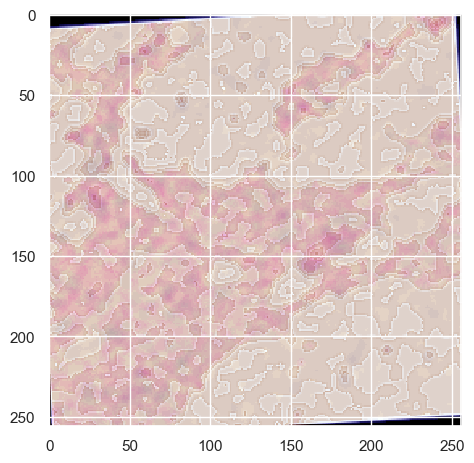

In [106]:
image = io.imread(train.iloc[0,1])

#先对所有通道进行处理，包括放大尺寸等等
img = seq_all(image)

#转换为HED色彩空间
img_hed = skimage.color.rgb2hed(img)

#转换完毕后，将HED色彩空间中的像素值归一化到[0,255]范围
for channel in [0,1,2]:
    img_hed[:,:,channel] = rescale_intensity(img_hed[:, :, channel], out_range=(0,255))    

#转化回uint8以供imgaug使用
img_hed = img_hed.astype("uint8")

#对三通道进行循环处理
for channel in [0,1,2]:
    img_aug = seq_channel(img_hed,channel)

#处理完毕后，再使用skimage转换回rgb，再归一化
img_rgb = skimage.color.hed2rgb(img_aug)
for channel in [0,1,2]:
    img_rgb[:,:,channel] = rescale_intensity(img_rgb[:, :, channel], out_range=(0,255))
    
#转化回uint8以供绘图使用
img_rgb = img_rgb.astype("uint8") 

io.imshow(img_rgb);

In [107]:
class SingleChannelTransform(object):
    """
    对图像进行HED转化，再在单通道上进行加减乘除，后转化回RGB的处理方法
    """
    def __init__(self):
        #对RGB图像进行处理的序列
        self.seq_all = iaa.Sequential(
            [iaa.Resize(256),iaa.Fliplr(0.5),iaa.Flipud(0.5)
             ,iaa.CropAndPad(percent=(0.01,0.02))
             ,iaa.MultiplyAndAddToBrightness(mul=(0.8,1.2),add=(-10,10))
             ,iaa.MultiplyHueAndSaturation(mul_hue=(0.9,1.2),mul_saturation=(0.8,0.9))
             ,iaa.Affine(scale={"x": (0.9, 1.1), "y": (0.9, 1.1)}
                         ,translate_percent={"x": (-0.05, 0.05), "y": (-0.05, 0.05)}
                         ,rotate=(-10, 10)
                         ,shear=(-3, 3)
                        )
            ]).augment_image
        
        #对单独通道来进行处理的函数
        def seq_channel(img,channel=0):
            seq = iaa.WithChannels([channel],[
                iaa.pillike.EnhanceContrast(factor=(0.6,0.8))
                ,iaa.Sometimes(0.5,iaa.AdditiveGaussianNoise(loc=1,scale=(0,0.001*255)))
                ,iaa.Add((-10,10)) #随机增加
                ,iaa.Multiply(0.5) #随机乘
                ,iaa.Sharpen(alpha=(0.1,1.0), lightness=(0.75, 1.5))
            ]).augment_image
            return seq(img)

        self.seq_channel = seq_channel
        
    def __call__(self, sample):
        
        image = sample

        #先对所有通道进行处理，包括放大尺寸等等
        img = seq_all(image)

        #转换为HED色彩空间
        img_hed = skimage.color.rgb2hed(img)

        #转换完毕后，将HED色彩空间中的像素值归一化到[0,255]范围
        for channel in [0,1,2]:
            img_hed[:,:,channel] = rescale_intensity(img_hed[:, :, channel], out_range=(0,255))    

        #转化回uint8以供imgaug使用
        img_hed = img_hed.astype("uint8")

        #对三通道进行循环处理
        for channel in [0,1,2]:
            img_aug = seq_channel(img_hed,channel)

        #处理完毕后，再使用skimage转换回rgb，再归一化
        img_rgb = skimage.color.hed2rgb(img_aug)
        for channel in [0,1,2]:
            img_rgb[:,:,channel] = rescale_intensity(img_rgb[:, :, channel], out_range=(0,255))

        #转化回uint8以供绘图使用
        img_rgb = img_rgb.astype("uint8") 
        
        return img_rgb

In [108]:
def alltransform(key="train", plot=False):
    train_sequence = [SingleChannelTransform(),transforms.ToPILImage()]
    test_val_sequence = [iaa.Resize(256).augment_image,transforms.ToPILImage()]       
    
    if plot==False:
        train_sequence.extend([transforms.ToTensor()
                               ,transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])                      
        test_val_sequence.extend([transforms.ToTensor()
                               ,transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
        
    data_transforms = {'train': transforms.Compose(train_sequence),'test_val': transforms.Compose(test_val_sequence)}
    
    return data_transforms[key]

In [109]:
train_ = CustomDataset(train,transform = alltransform(key="train",plot=True))

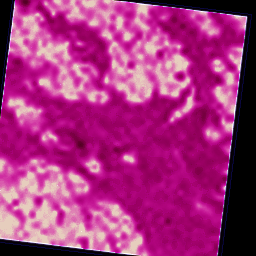

In [110]:
train_[0]["patch"]